# Thought process for considering YOLO approach.

This is re-attempt on approach to seperate "Target Corp logo with combined label (Bull's eye)" from the environment with "only Target Corp logo (Bull's eye)". 
- After careful consideration of different approaches from trying out CNN approach to EfficientDet Tensorflow API, I realised that the results were inconsistent due to lack of image data. 
- An object detection algorithm namely **"You look only once"** or ***YOLO*** that divides images into a grid system where each cell in the grid is responsible for detecting objects within itself is ideal in such conditions. The challenge here was to annotate the image data in YOLOv5 PyTorch format.
- ***Manually annotated every image*** downloaded over Google Search to convert to required XML form using ROBOFLOW library.

In [ ]:
!git clone https://github.com/ultralytics/yolov5
%cd yolov5
%pip install -qr requirements.txt
%pip install -q roboflow

Cloning into 'yolov5'...
remote: Enumerating objects: 12367, done.
remote: Counting objects: 100% (75/75), done.
remote: Compressing objects: 100% (59/59), done.
remote: Total 12367 (delta 33), reused 34 (delta 16), pack-reused 12292
Receiving objects: 100% (12367/12367), 12.70 MiB | 31.88 MiB/s, done.
Resolving deltas: 100% (8502/8502), done.
/content/yolov5
     |████████████████████████████████| 1.6 MB 9.4 MB/s 
     |████████████████████████████████| 145 kB 6.5 MB/s 
     |████████████████████████████████| 178 kB 52.4 MB/s 
     |████████████████████████████████| 1.1 MB 51.3 MB/s 
     |████████████████████████████████| 67 kB 5.7 MB/s 
     |████████████████████████████████| 54 kB 3.1 MB/s 
     |████████████████████████████████| 138 kB 74.3 MB/s 
     |████████████████████████████████| 62 kB 1.7 MB/s 


In [ ]:
import torch 
import os
from IPython.display import Image, clear_output


### Imported Roboflow and selected YOLO version 5.

In [ ]:
from roboflow import Roboflow
rf = Roboflow(model_format="yolov5", notebook="ultralytics")


upload and label your dataset, and get an API KEY here: https://app.roboflow.com/?model=yolov5&ref=ultralytics


Below code is specific to Colab Notebook for setting up default directory.

In [ ]:
os.environ["DATASET_DIRECTORY"]="/content/datasets"

Importing my manually annotated dataset with the use of an API Key.

# My approach:
- Annotated the images with "label and logo together". ***Results were still not consistent***.
- Provided null image data for images with only logo without label.

### This resulted in consistent prediction.

In [ ]:
rf = Roboflow(api_key="1tBxDC3gXlsiO8DPZ7Lw")
project = rf.workspace("soroco").project("target-logo-with-label")
dataset = project.version(5).download("yolov5")

loading Roboflow workspace...
loading Roboflow project...


Extracting Dataset Version Zip to /content/datasets/Target-Logo-with-label-5 in yolov5pytorch:: 100%|██████████| 378/378 [00:00<00:00, 1678.60it/s]


Used image size of 416X416 pixels of 16 batches and performed 100 epochs using weights of YOLO and stored in cache

In [ ]:
!python train.py --img 416 --batch 16 --epochs 100 --data {dataset.location}/data.yaml --weights yolov5s.pt --cache

train: weights=yolov5s.pt, cfg=, data=/content/datasets/Target-Logo-with-label-5/data.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=100, batch_size=16, imgsz=416, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=ram, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=runs/train, name=exp, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, seed=0, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: up to date with https://github.com/ultralytics/yolov5 ✅
YOLOv5 🚀 v6.2-123-g5e1a955 Python-3.7.14 torch-1.12.1+cu113 CUDA:0 (Tesla T4, 15110MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, cls_pw=1.0, obj=1.0, obj_pw=1.0, iou_t=0.2, anchor_t=4.0, fl_gamma

In [ ]:
# %load_ext tensorboard
# %tensorboard --logdir runs

Ran detect.py from yolo clone which rans various paramenters . Here paramenters provided are image size of 416 X 416 and confidence cutoff of 35%.

In [ ]:
!python detect.py --weights runs/train/exp/weights/best.pt --img 416 --conf 0.35 --source {dataset.location}/valid/images

detect: weights=['runs/train/exp/weights/best.pt'], source=/content/datasets/Target-Logo-with-label-5/valid/images, data=data/coco128.yaml, imgsz=[416, 416], conf_thres=0.35, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v6.2-123-g5e1a955 Python-3.7.14 torch-1.12.1+cu113 CUDA:0 (Tesla T4, 15110MiB)

Fusing layers... 
Model summary: 157 layers, 7012822 parameters, 0 gradients, 15.8 GFLOPs
image 1/51 /content/datasets/Target-Logo-with-label-5/valid/images/1 (2).jpg: 288x416 1 Logo, 11.4ms
image 2/51 /content/datasets/Target-Logo-with-label-5/valid/images/1.jpg: 416x416 (no detections), 10.9ms
image 3/51 /content/datasets/Target-Logo-with-label-5/valid/images/10 (2).jpg: 320x416 1 Logo, 11.5ms
i

Results show improved detection of desired logo with label segregation from only label images using bounding box showing confidence probability.

Here for loop is used for less than 80 images as I had almost 50 Images to test on the model.

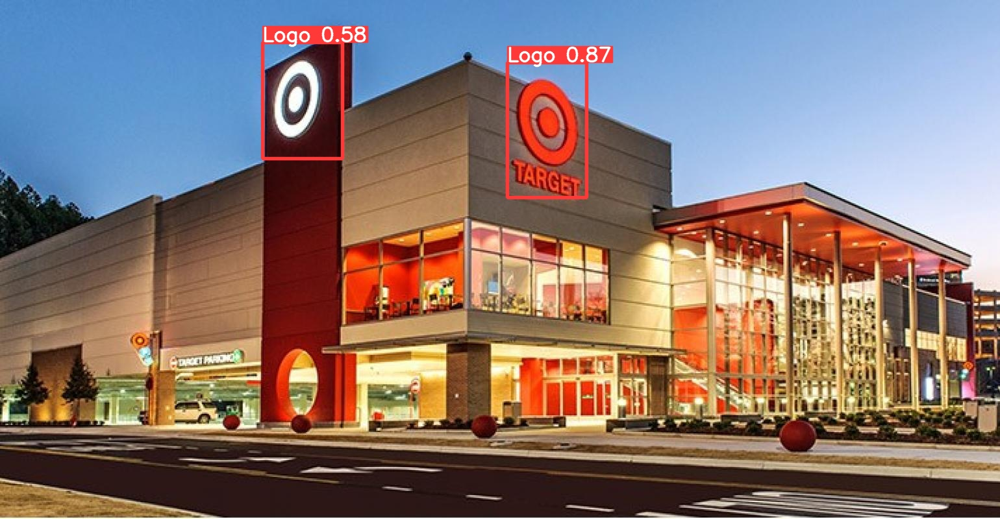

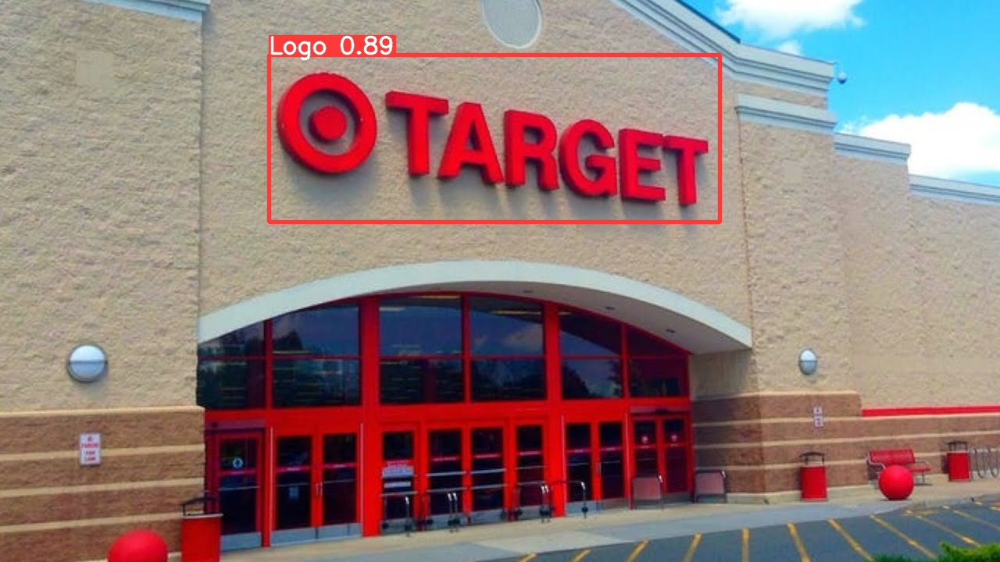

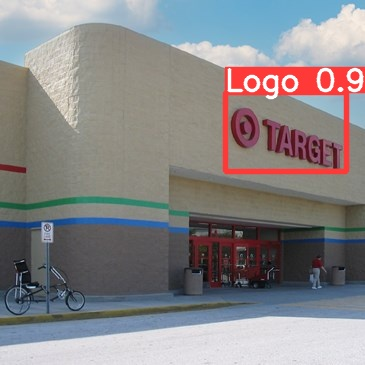

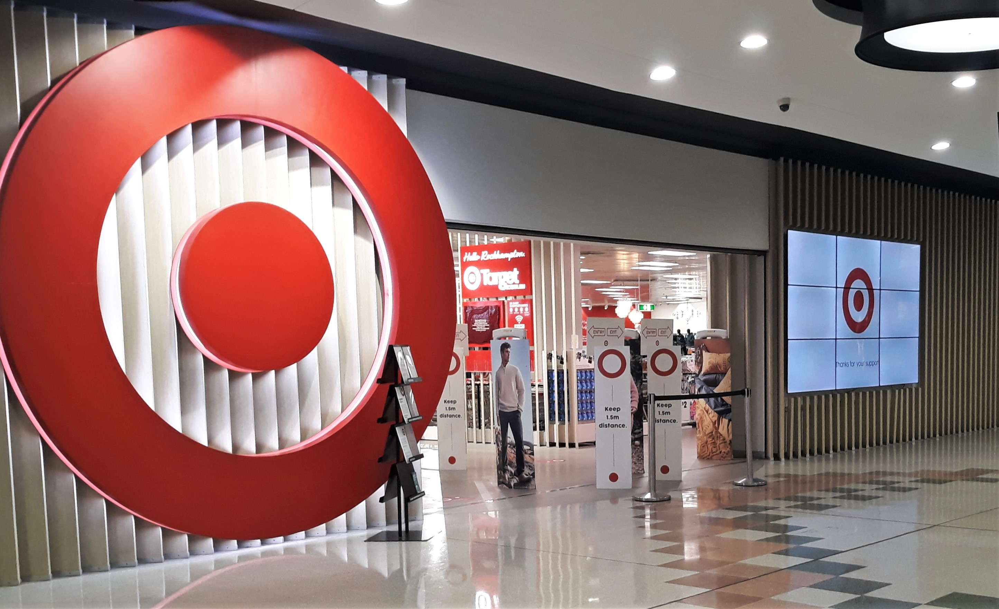

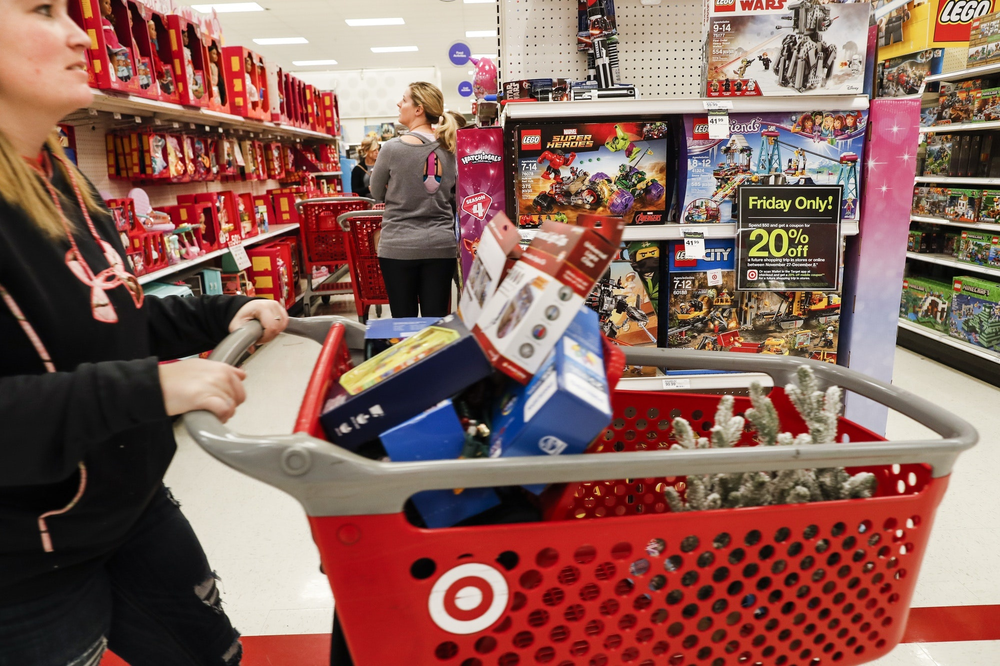

...

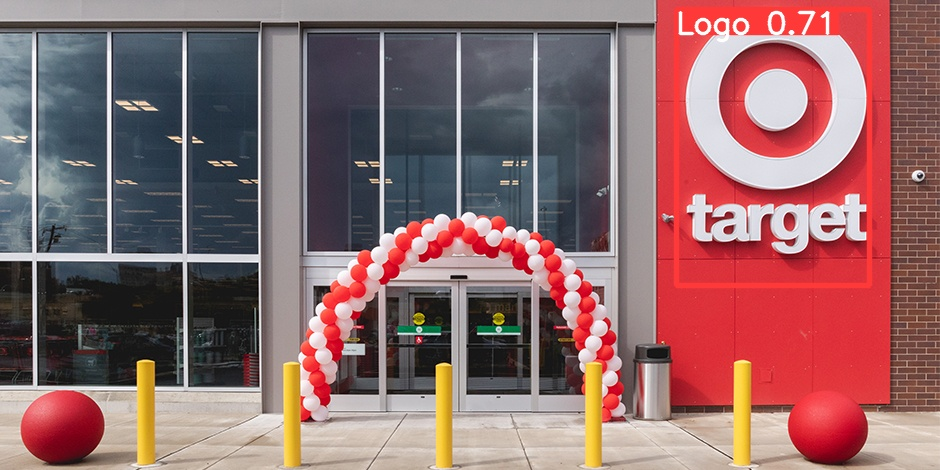

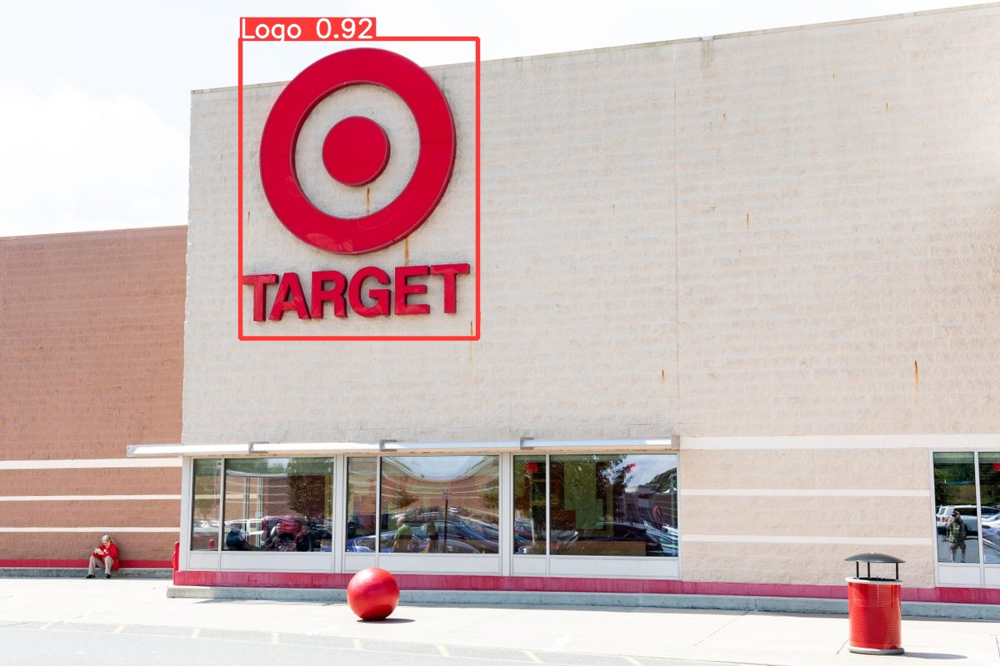

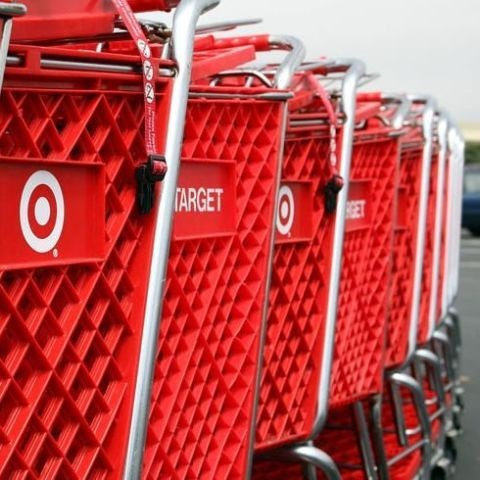

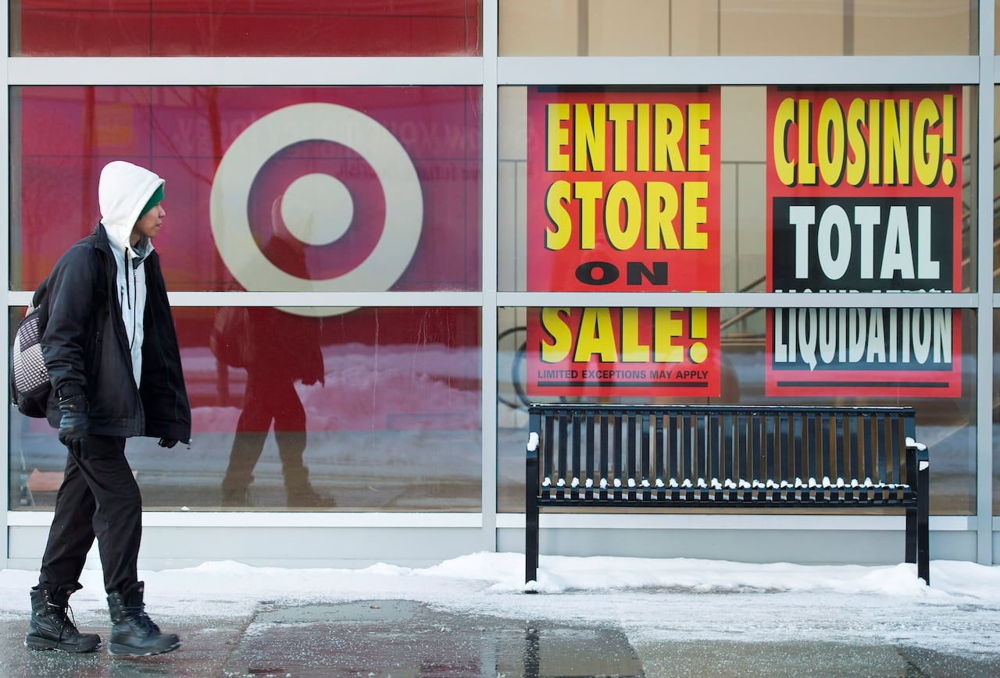

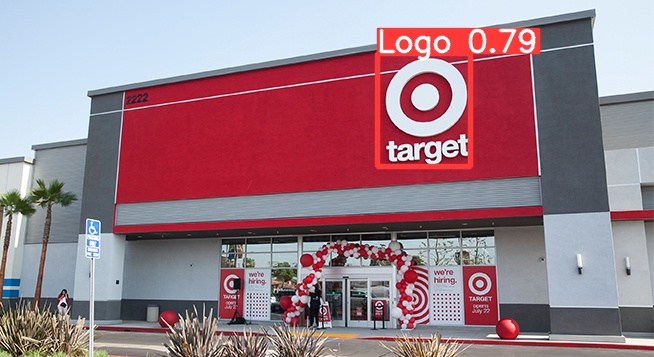

In [ ]:
import glob
from IPython.display import Image, display

i = 0
for imageName in glob.glob('/content/yolov5/runs/detect/exp/*.jpg'):
  i+=1
  if i<80:
    display(Image(filename=imageName))
    print("\n")

This is an optional code to download the model for external usage.

In [ ]:
from google.colab import files
files.download('./runs/train/exp/weights/best.pt')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

# How to scale this to mask for 1000 images?
***Response***: According to me, scalability can be addressed using divide and conquer technique. 
By thinking of "Detection" and "Identification" as different processes, essentially the first part will look at the scene and identify the region that corresponds to alogo and the other part will identify it. This can be optimized by applying the latest AI advances to each component to scale it effectively.
However, possible challenges will be need to lot of quality data and efficient training.